<a href="https://colab.research.google.com/gist/Aaarin12/36bf1b40f9a8e576c594936d9791dcd6/lingonberry-object-detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!nvidia-smi

Sat Feb 22 08:34:21 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   55C    P8             10W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 921.5/921.5 kB 24.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 100.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 85.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 57.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 88.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

In [3]:
import ultralytics
ultralytics.checks()

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 33.2/235.7 GB disk)


In [4]:
from ultralytics import YOLO
from IPython.display import display, Image

In [6]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="EwfHIT9w5sdIPsyyFO5v")
project = rf.workspace("image-analysis-0mduj").project("lingonberry-detection")
version = project.version(6)
dataset = version.download("yolov12")


loading Roboflow workspace...
loading Roboflow project...


In [7]:
dataset.location

'/content/Lingonberry-detection-6'

In [8]:
! yolo task=detect mode=train data={dataset.location}/data.yaml model="yolo12s.pt" epochs=60 imgsz=800

100% 18.1M/18.1M [00:00<00:00, 139MB/s] 
Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12s.pt, data=/content/Lingonberry-detection-6/data.yaml, epochs=60, time=None, patience=100, batch=16, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save

In [9]:
from IPython.display import display, Image

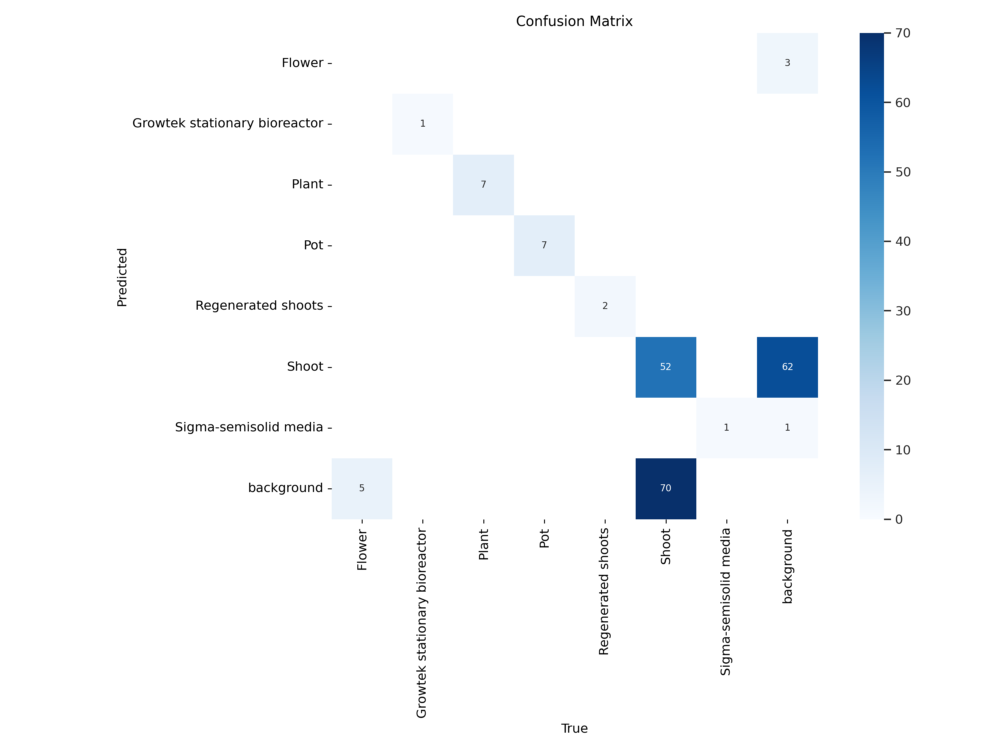

In [78]:
Image ("/content/runs/detect/train/confusion_matrix.png", width= 900)

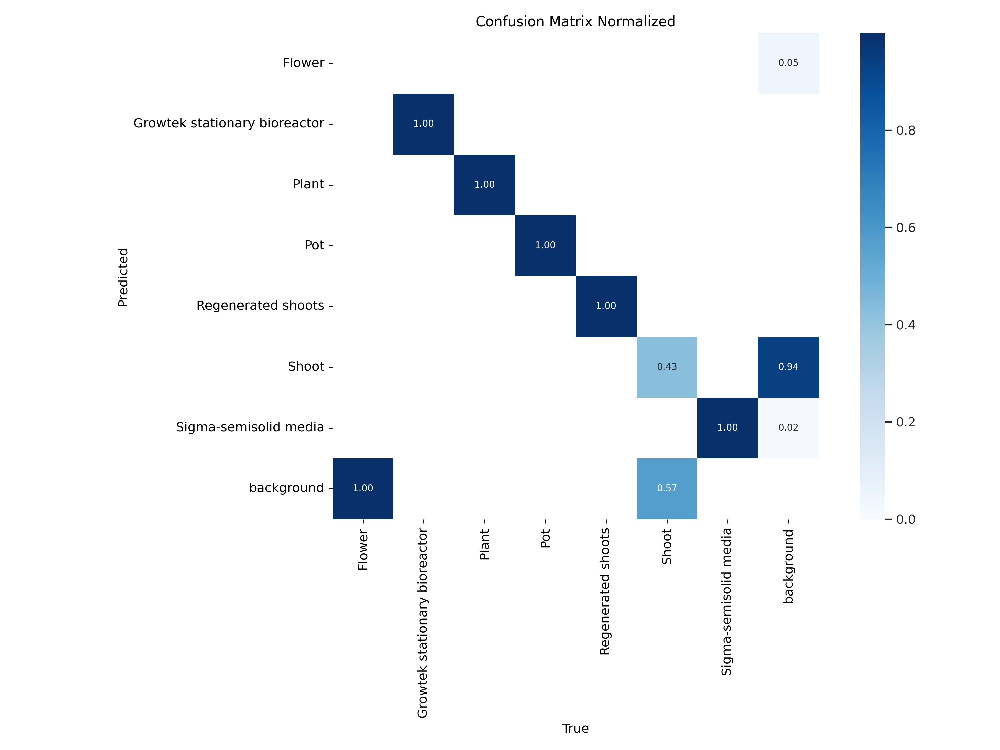

In [77]:
Image ("/content/runs/detect/train/confusion_matrix_normalized.png", width= 900)

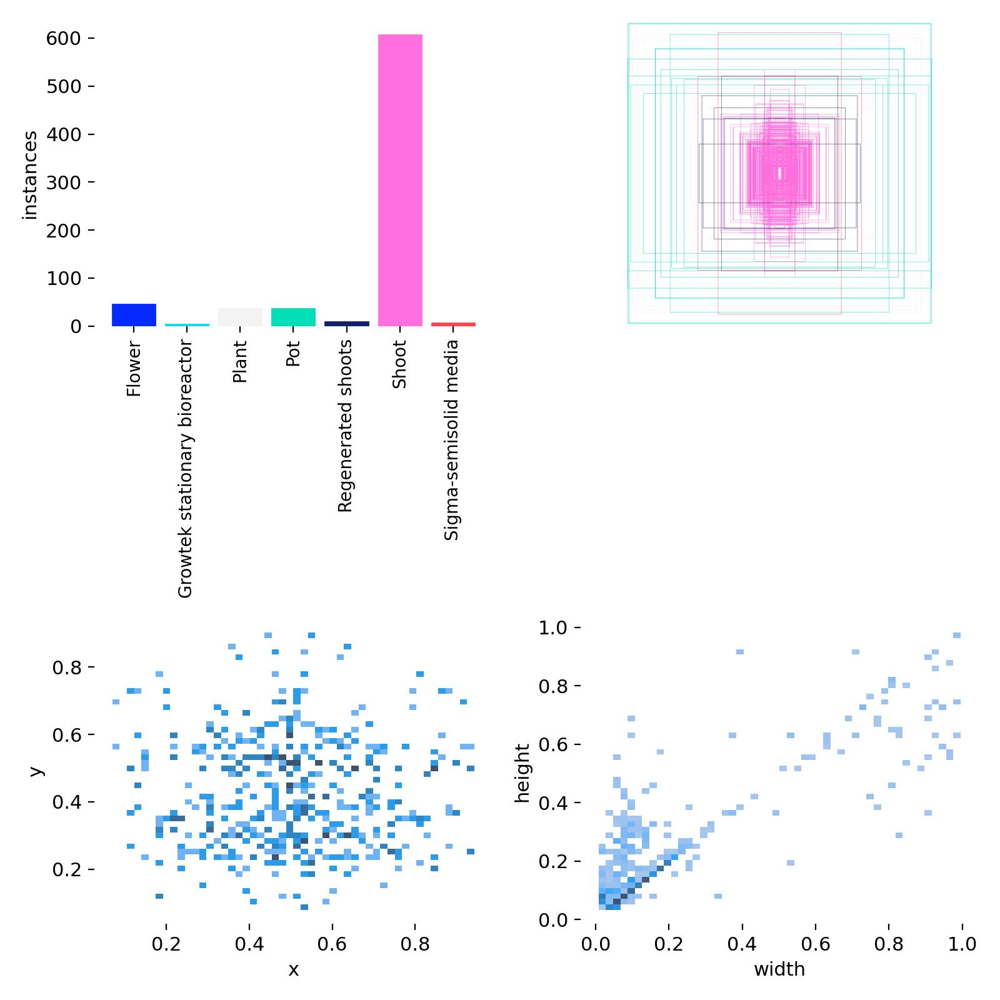

In [76]:
Image ("/content/runs/detect/train/labels.jpg", width= 900)

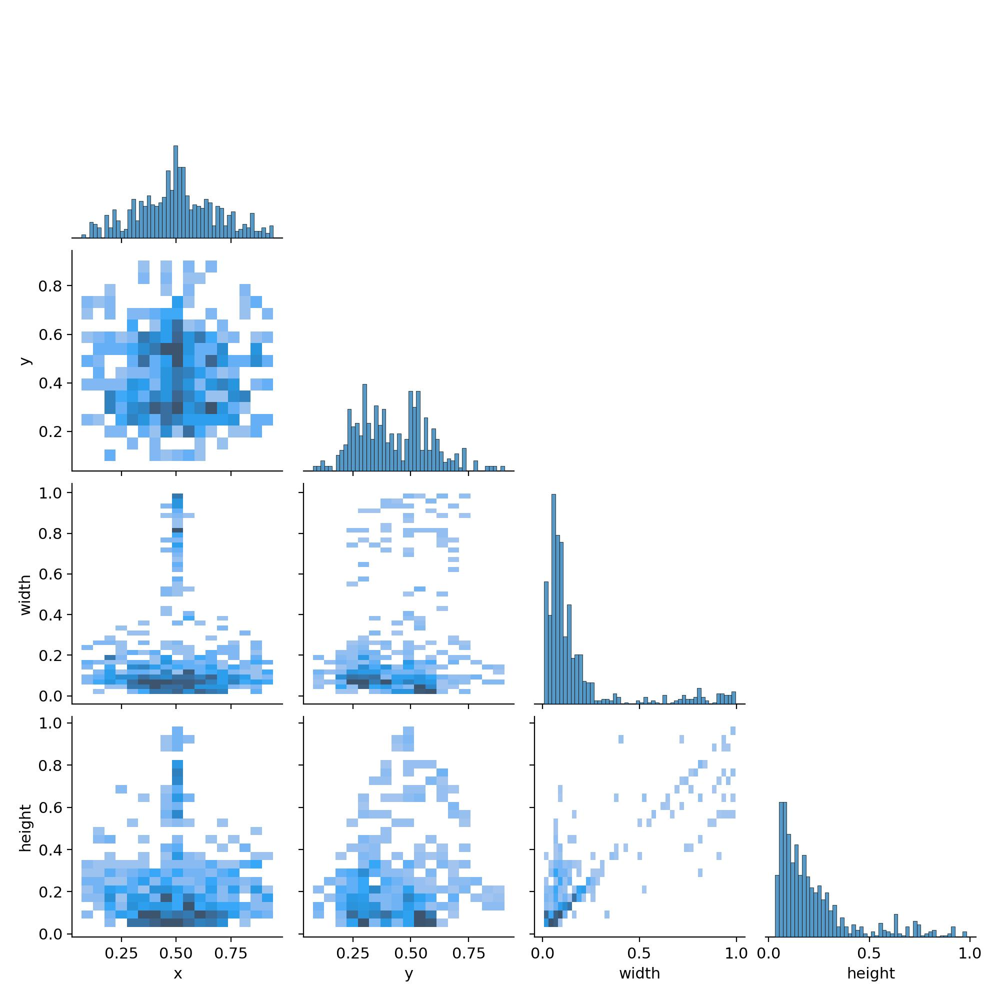

In [75]:
Image ("/content/runs/detect/train/labels_correlogram.jpg", width= 900)

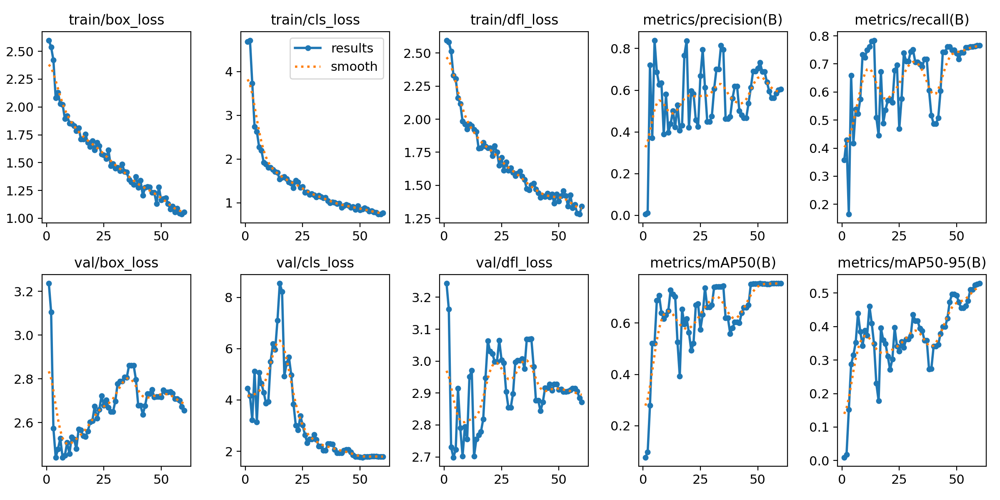

In [74]:
Image ("/content/runs/detect/train/results.png", width= 900)

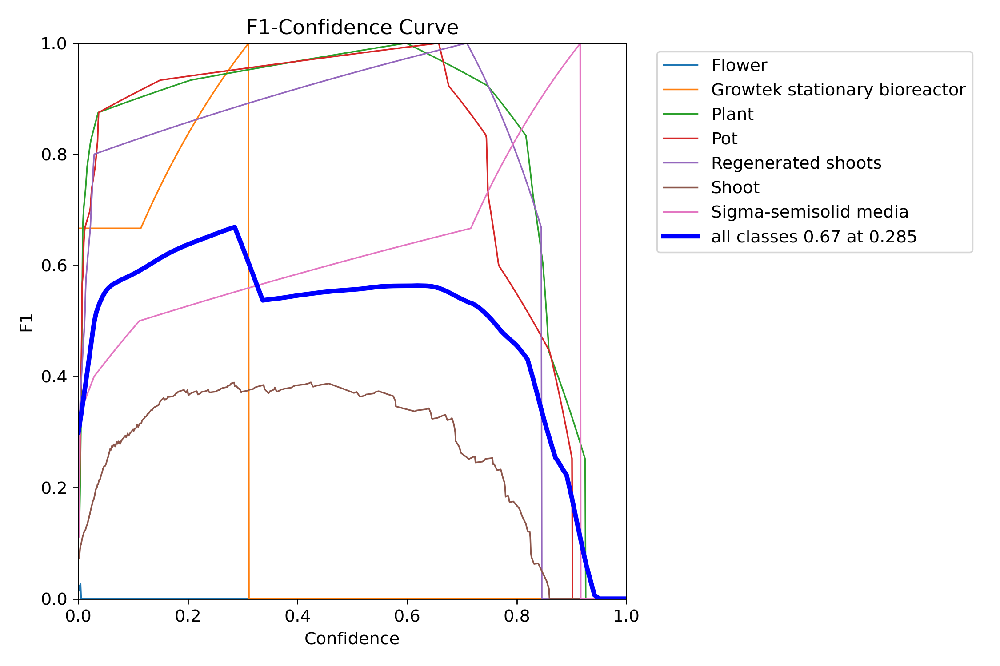

In [73]:
Image ("/content/runs/detect/train/F1_curve.png", width= 600)

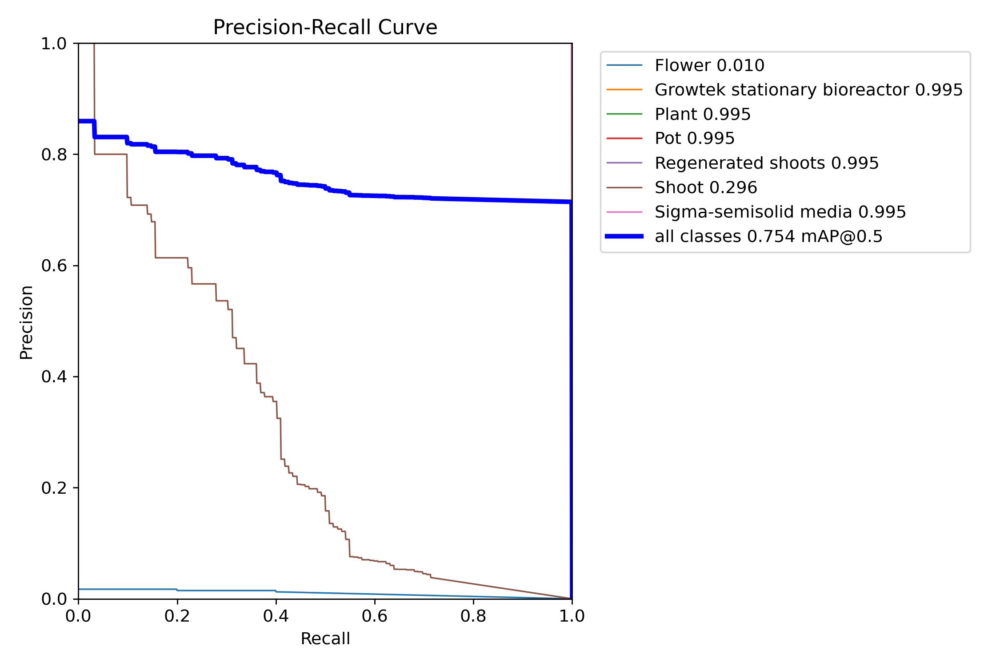

In [72]:
Image ("/content/runs/detect/train/PR_curve.png", width= 600)

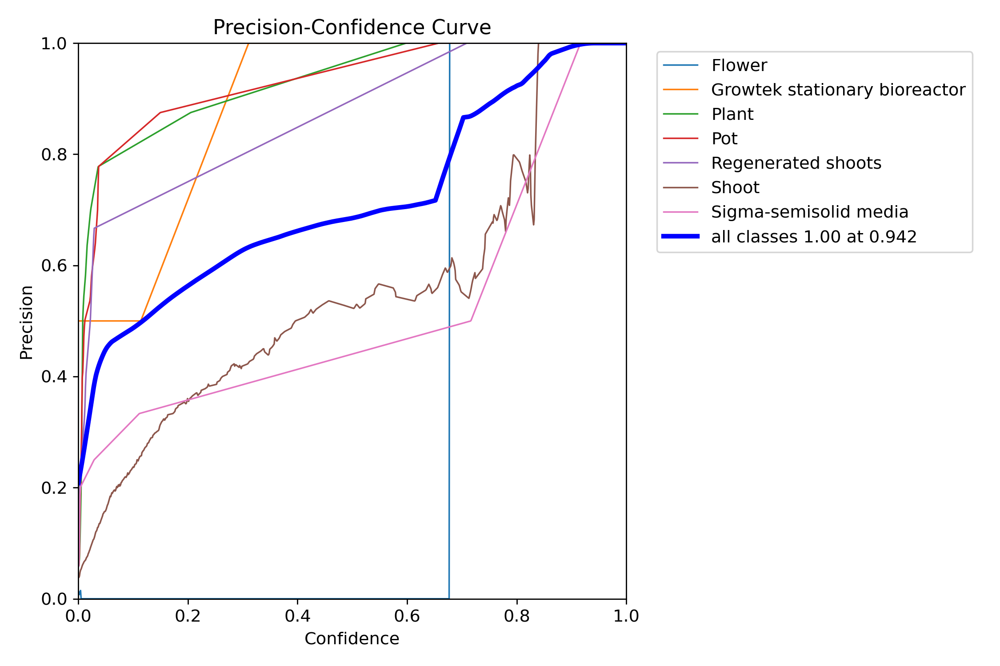

In [71]:
Image ("/content/runs/detect/train/P_curve.png", width= 600)

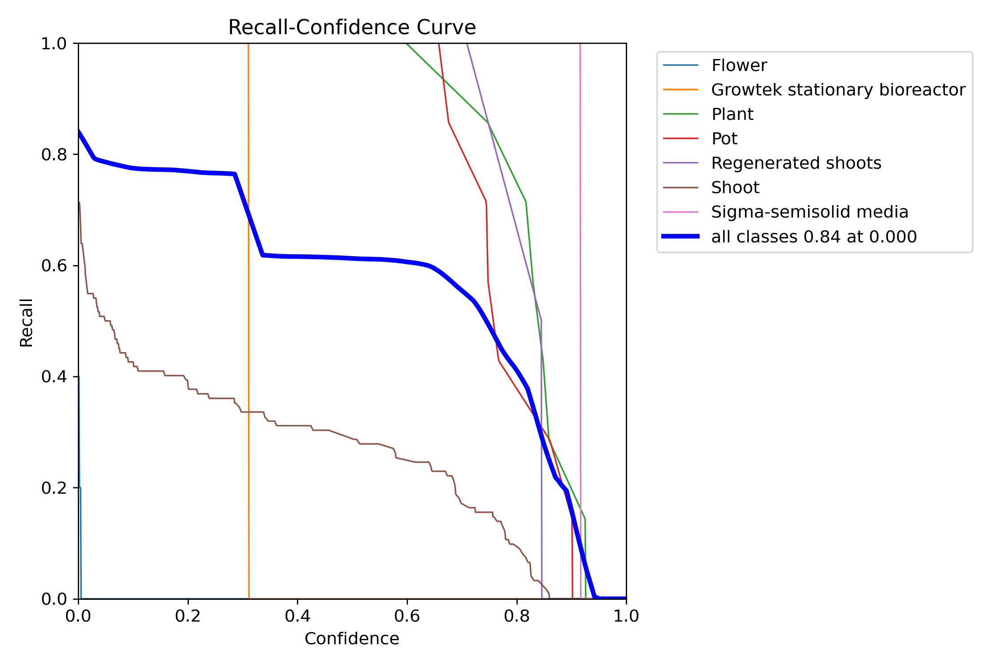

In [70]:
Image ("/content/runs/detect/train/R_curve.png", width= 600)

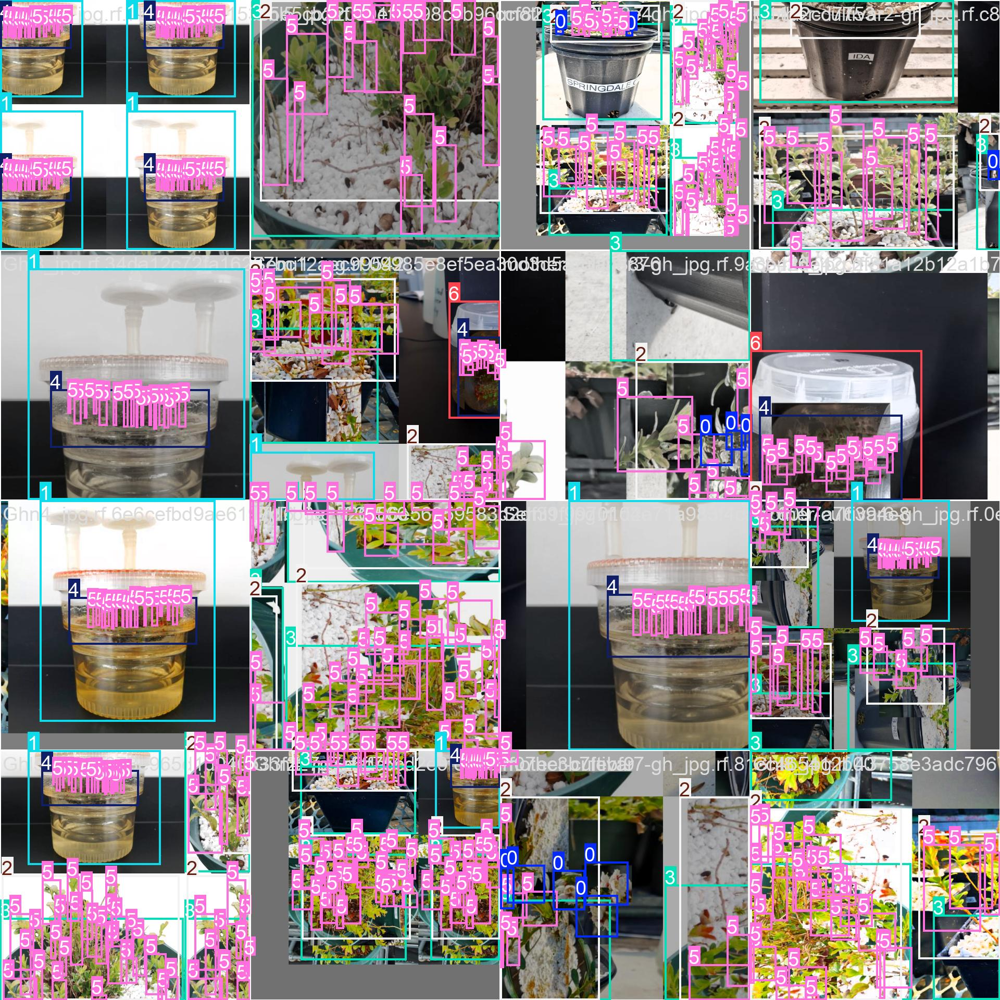

In [69]:
Image ("/content/runs/detect/train/train_batch0.jpg", width= 900)

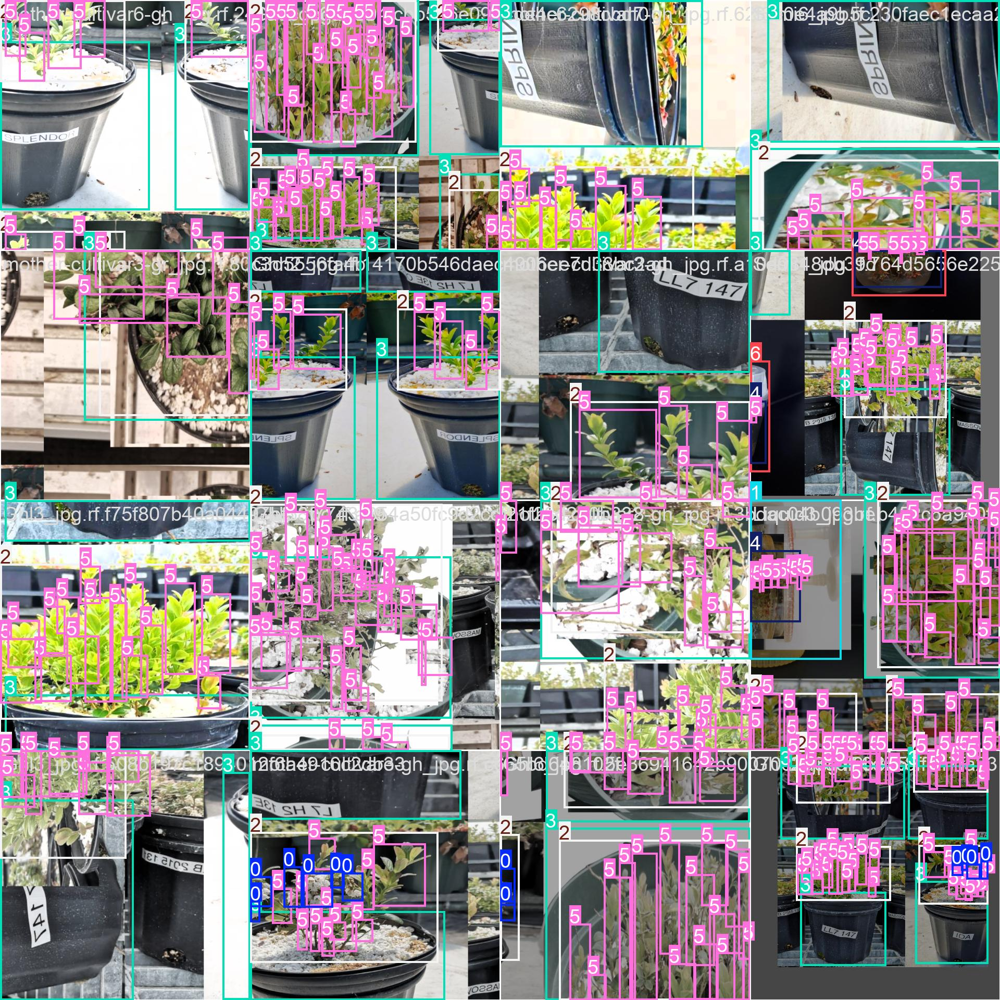

In [68]:
Image ("/content/runs/detect/train/train_batch1.jpg", width= 900)

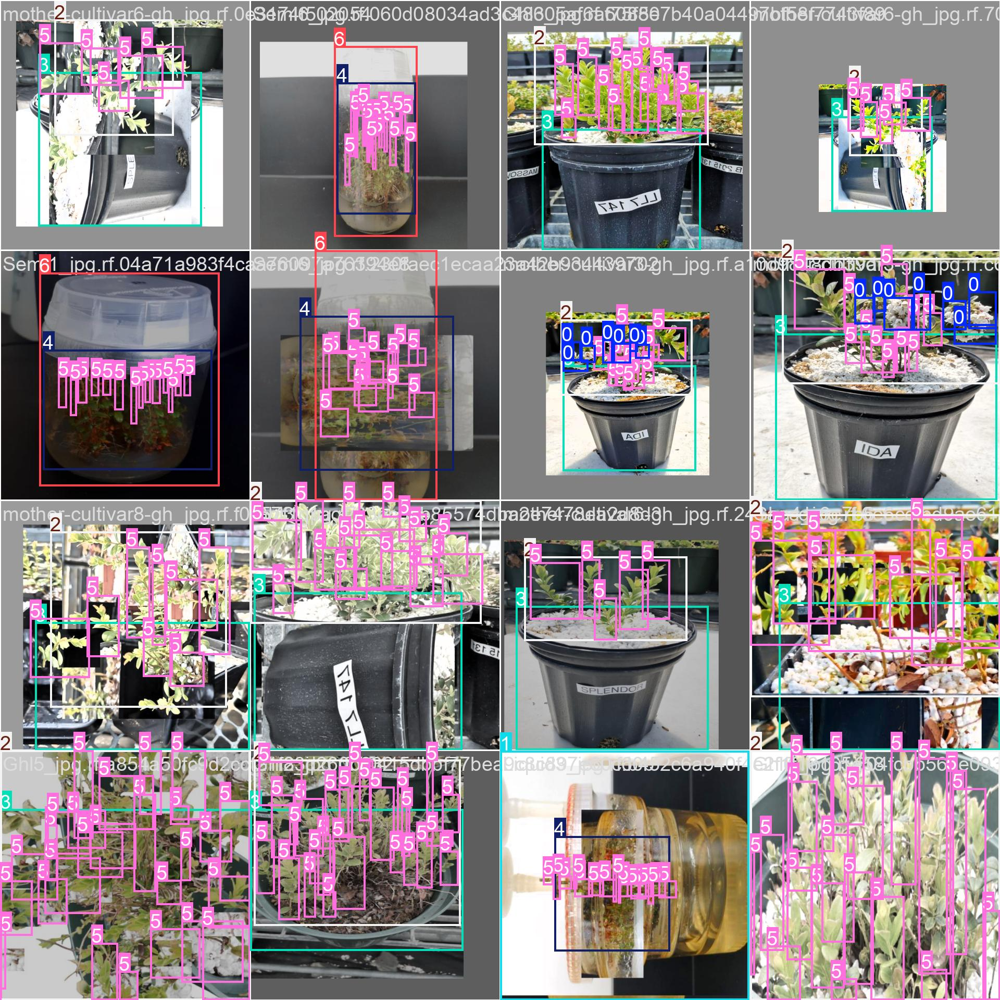

In [67]:
Image ("/content/runs/detect/train/train_batch150.jpg", width= 900)

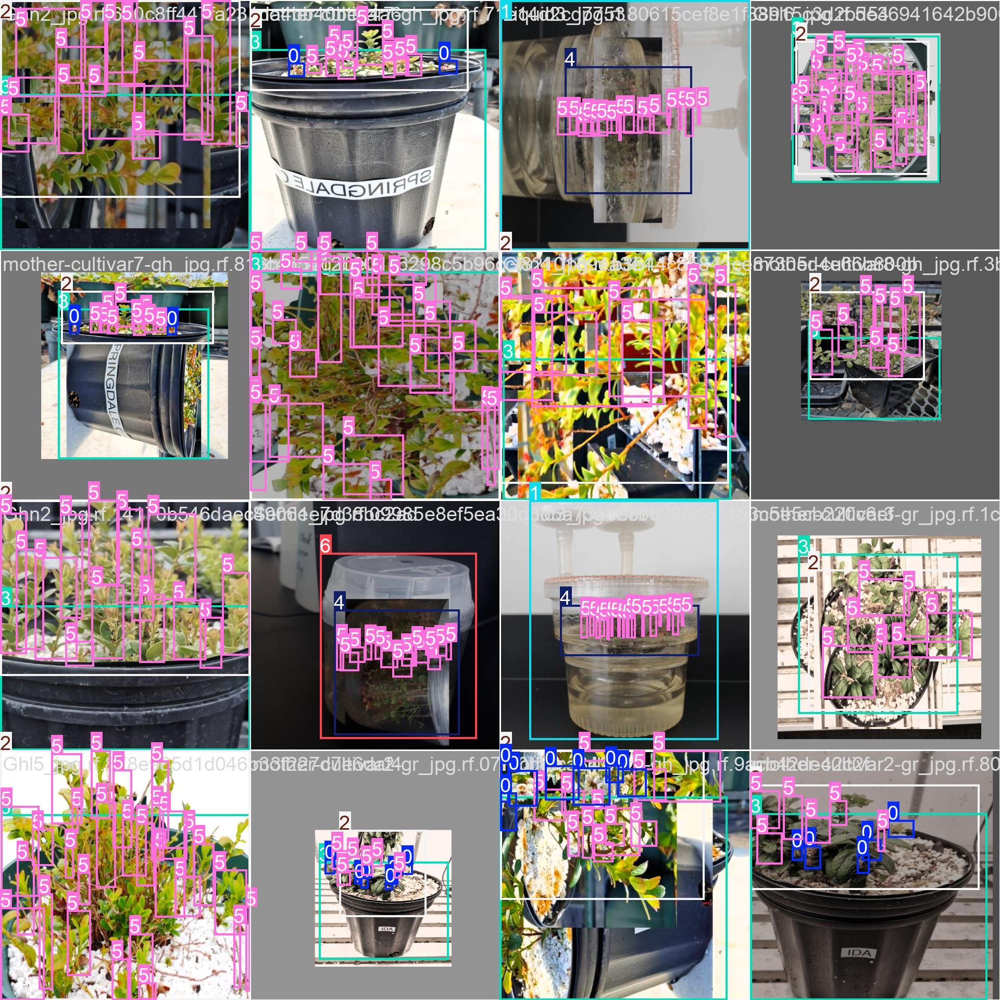

In [66]:
Image ("/content/runs/detect/train/train_batch151.jpg", width= 900)

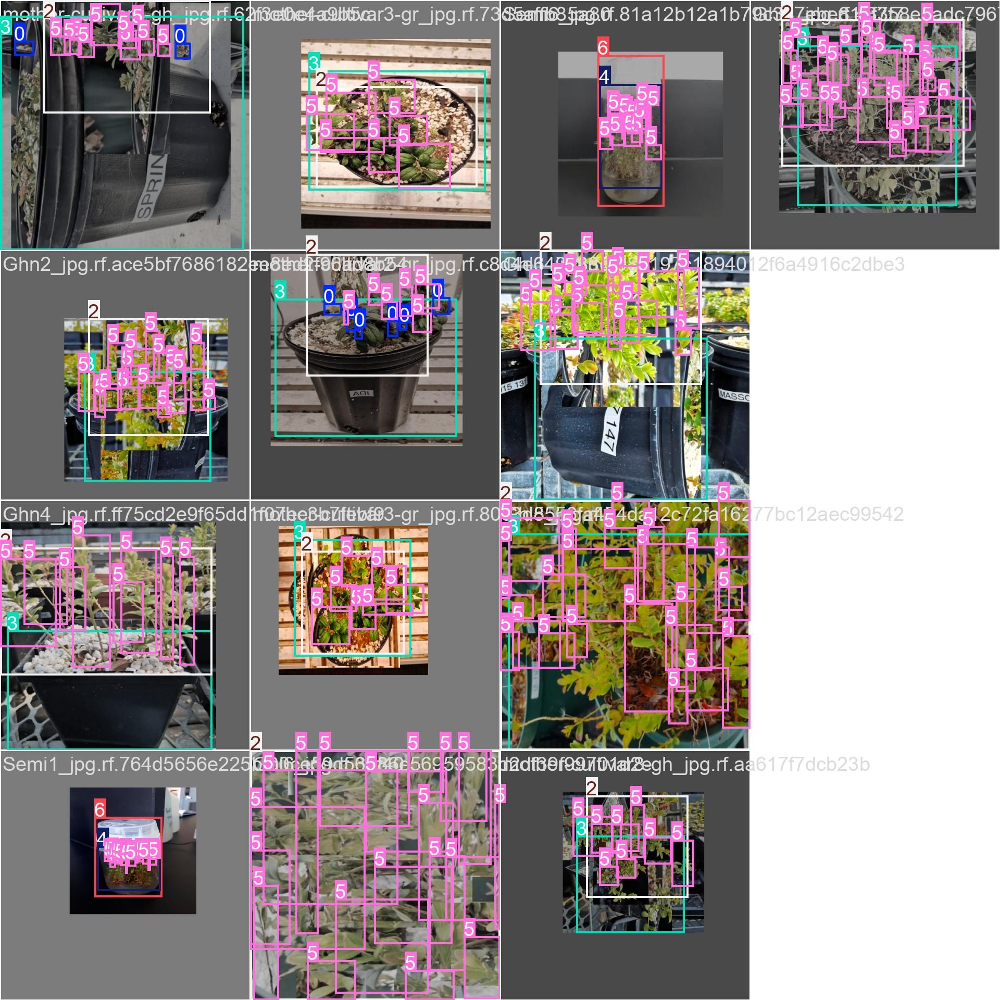

In [65]:
Image ("/content/runs/detect/train/train_batch152.jpg", width= 900)

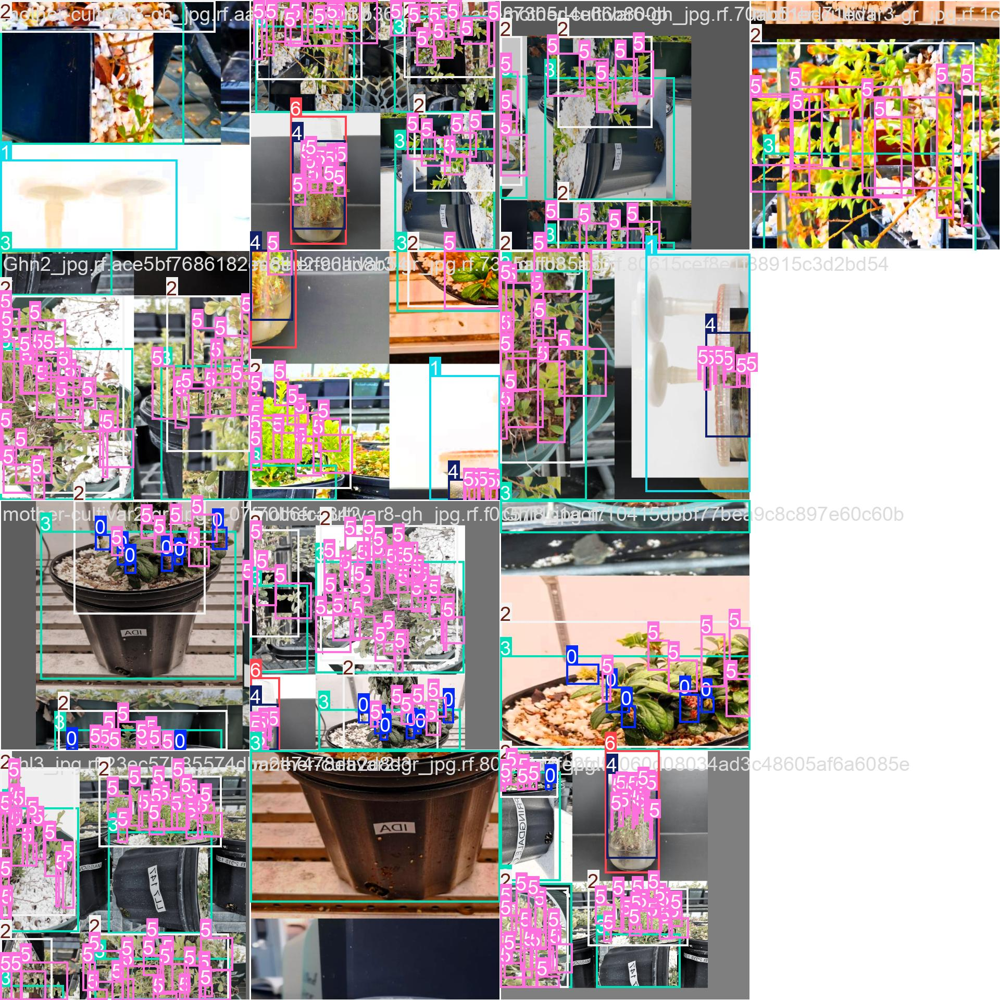

In [64]:
Image ("/content/runs/detect/train/train_batch2.jpg", width= 900)

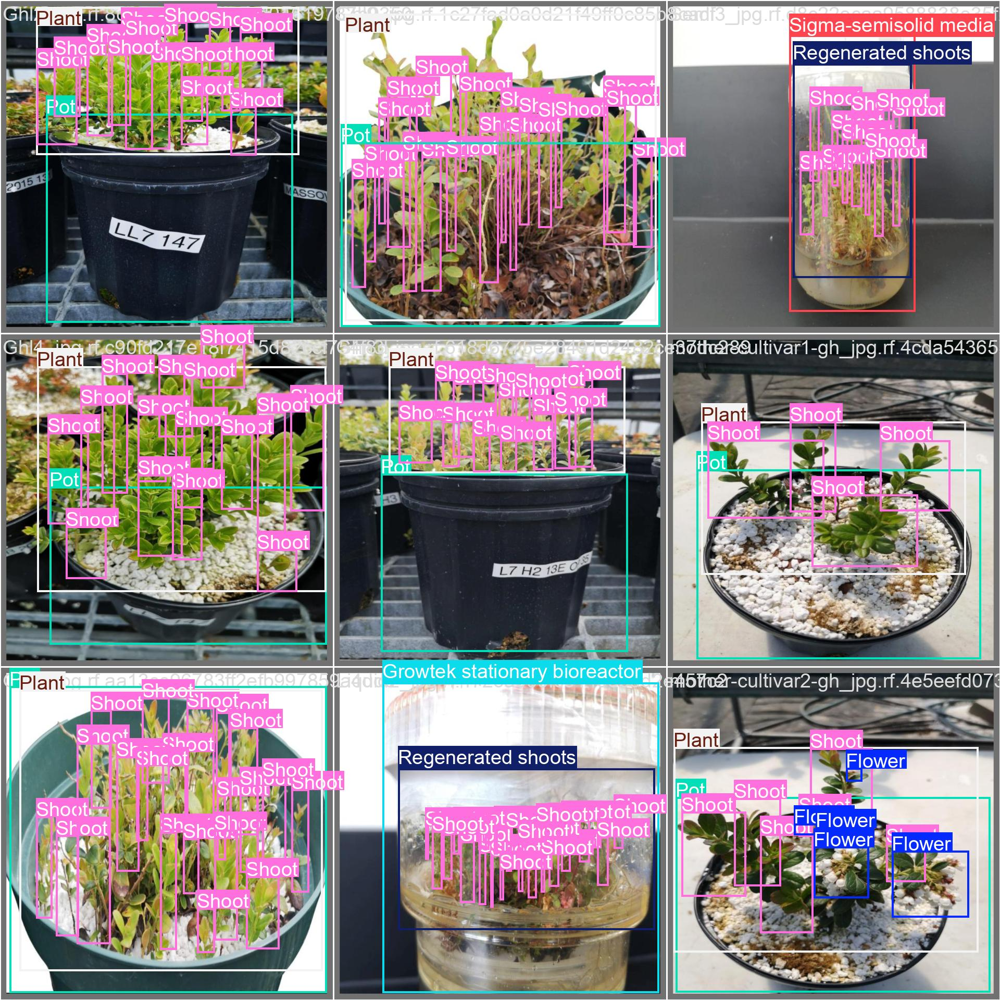

In [63]:
Image ("/content/runs/detect/train/val_batch0_labels.jpg", width= 900)

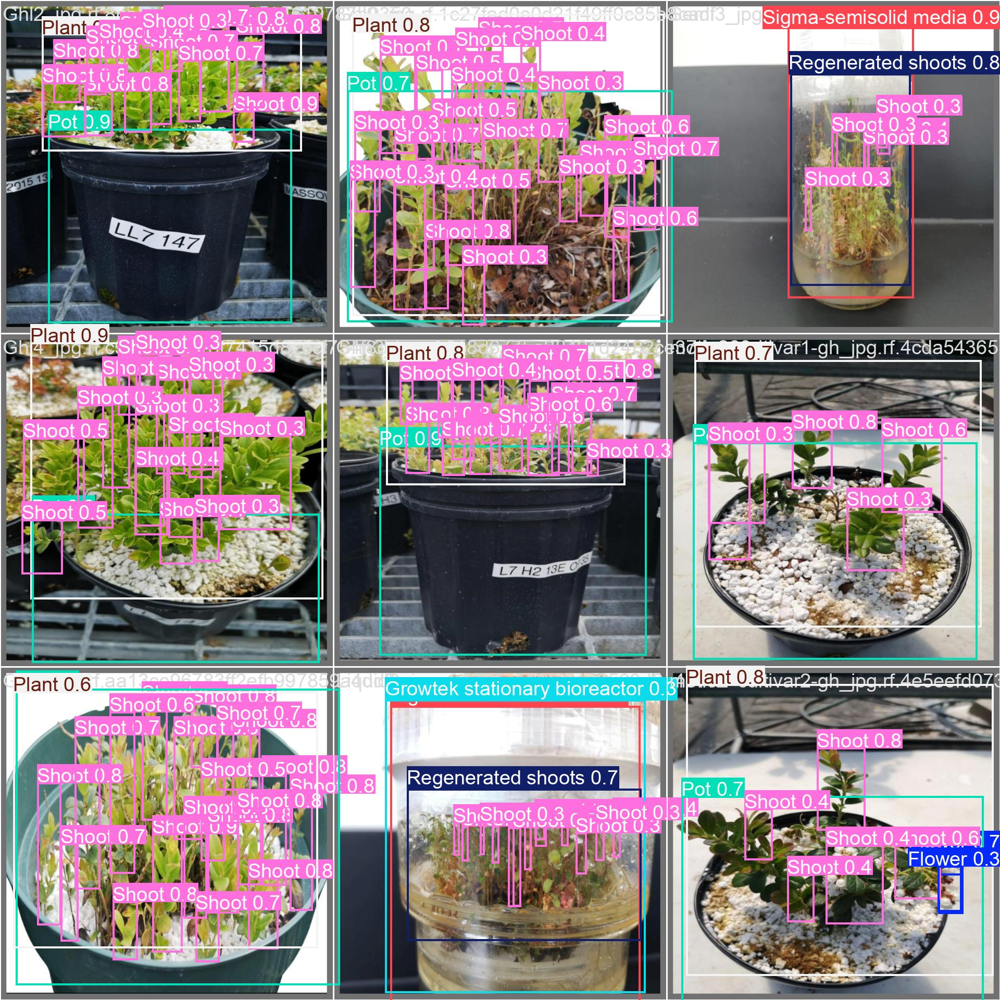

In [62]:
Image ("/content/runs/detect/train/val_batch0_pred.jpg", width= 900)

In [27]:
! yolo task=detect mode=val model="/content/runs/detect/train/weights/best.pt" data={dataset.location}/data.yaml

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs
val: Scanning /content/Lingonberry-detection-6/valid/labels.cache... 9 images, 0 backgrounds, 0 corrupt: 100% 9/9 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 1/1 [00:00<00:00,  1.68it/s]
                   all          9        145      0.606      0.767      0.754      0.529
                Flower          1          5          0          0     0.0103    0.00324
Growtek stationary bioreactor          1          1      0.874          1      0.995      0.796
                 Plant          7          7      0.894          1      0.995      0.591
                   Pot          7          7      0.904          1      0.995      0.646
    Regenerated shoots          2          2      0.783          1      0.995      0.699
                 Shoot          9    

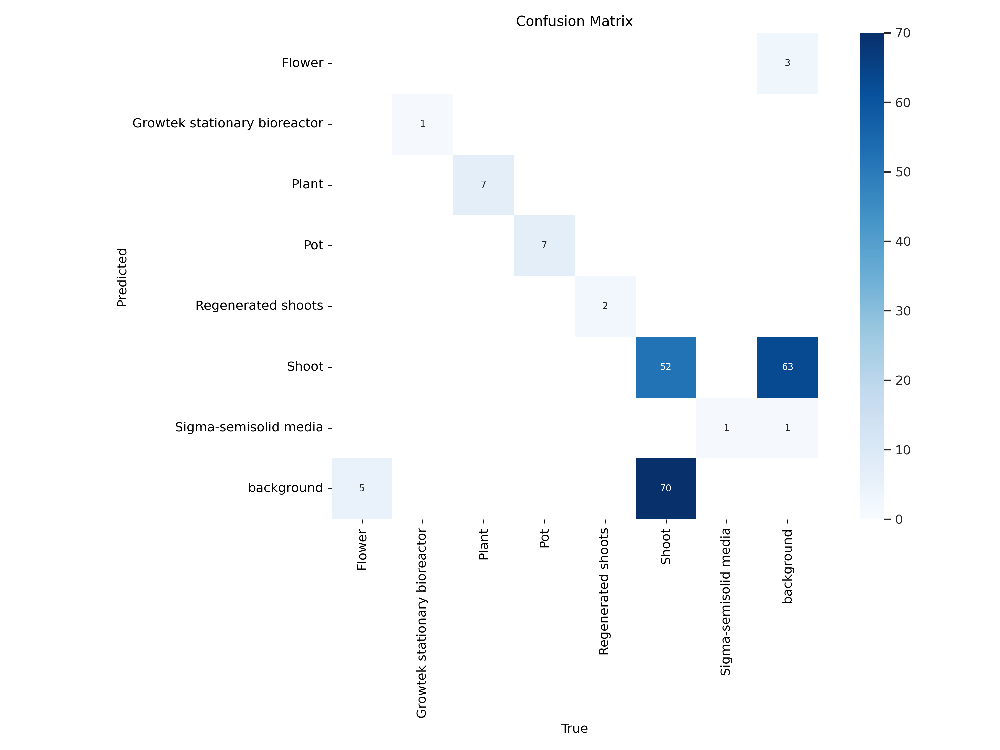

In [61]:
Image ("/content/runs/detect/val/confusion_matrix.png", width= 900)

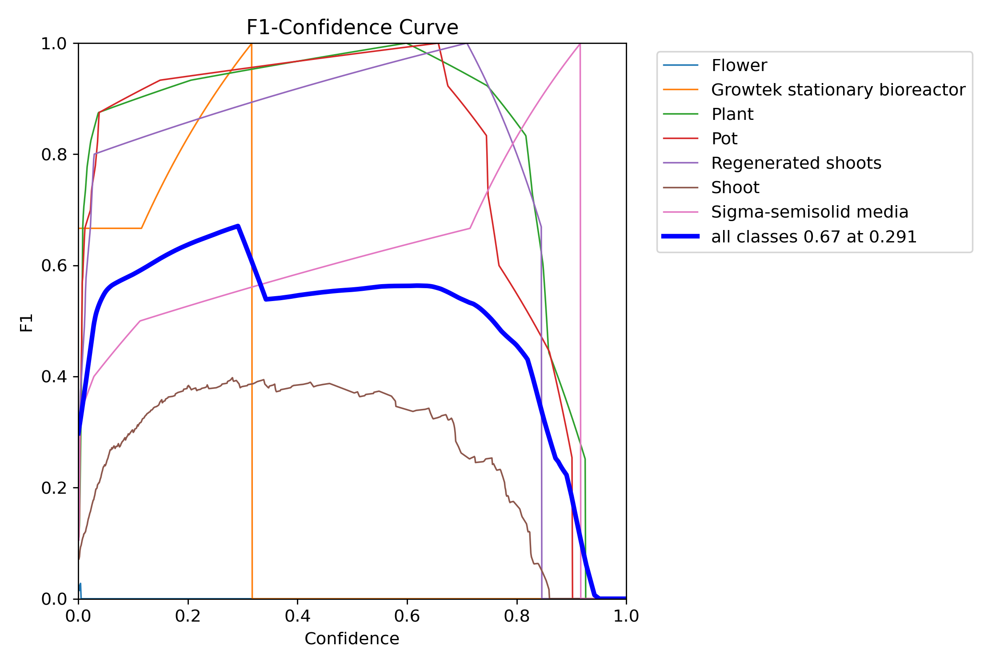

In [60]:
Image ("/content/runs/detect/val/F1_curve.png", width= 600)

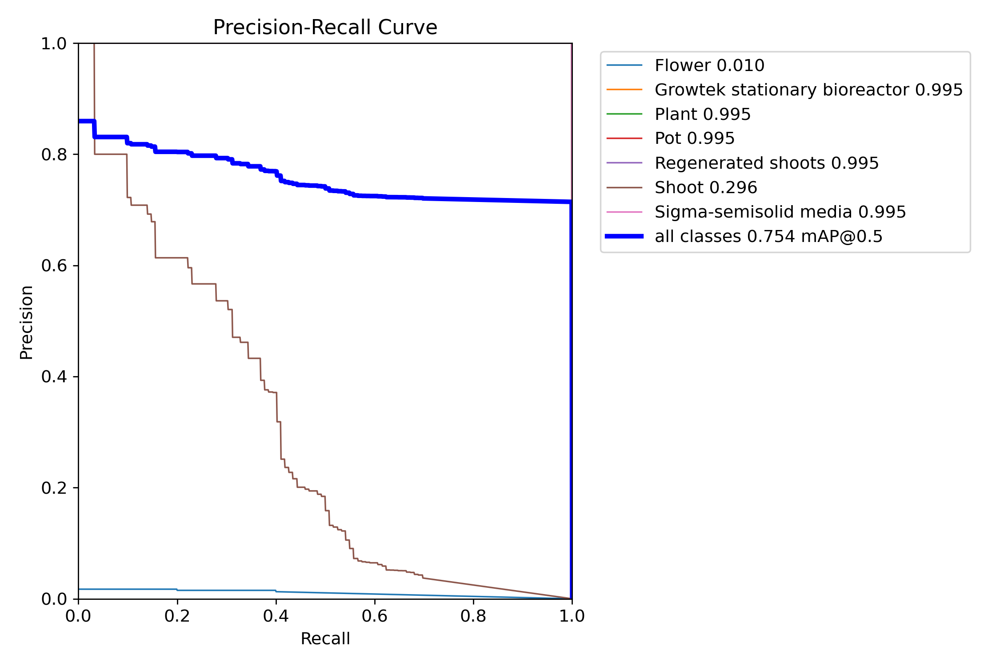

In [59]:
Image ("/content/runs/detect/val/PR_curve.png", width= 600)

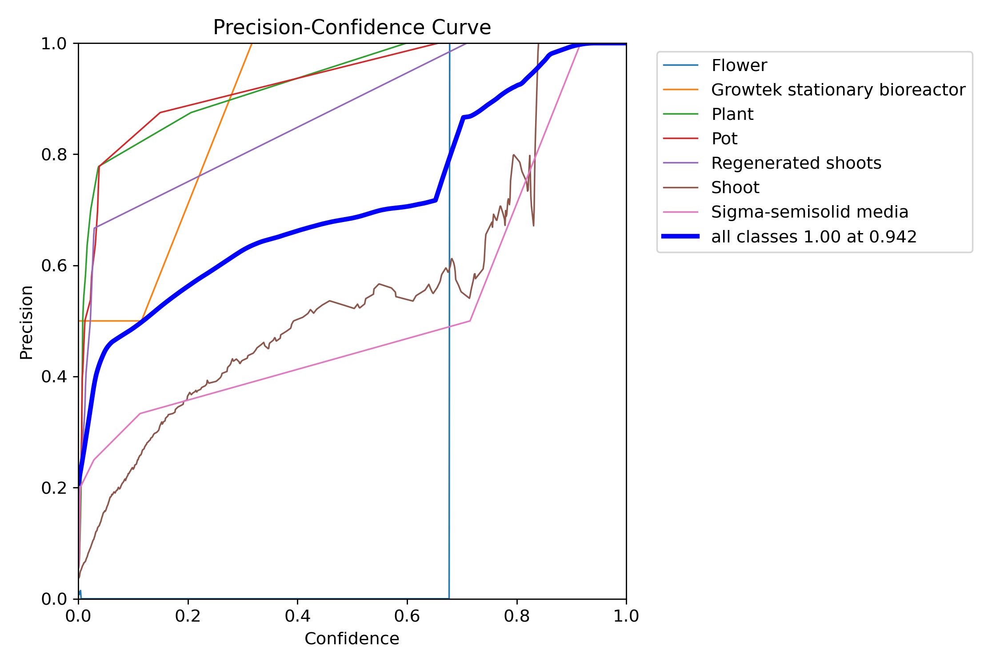

In [58]:
Image ("/content/runs/detect/val/P_curve.png", width= 600)

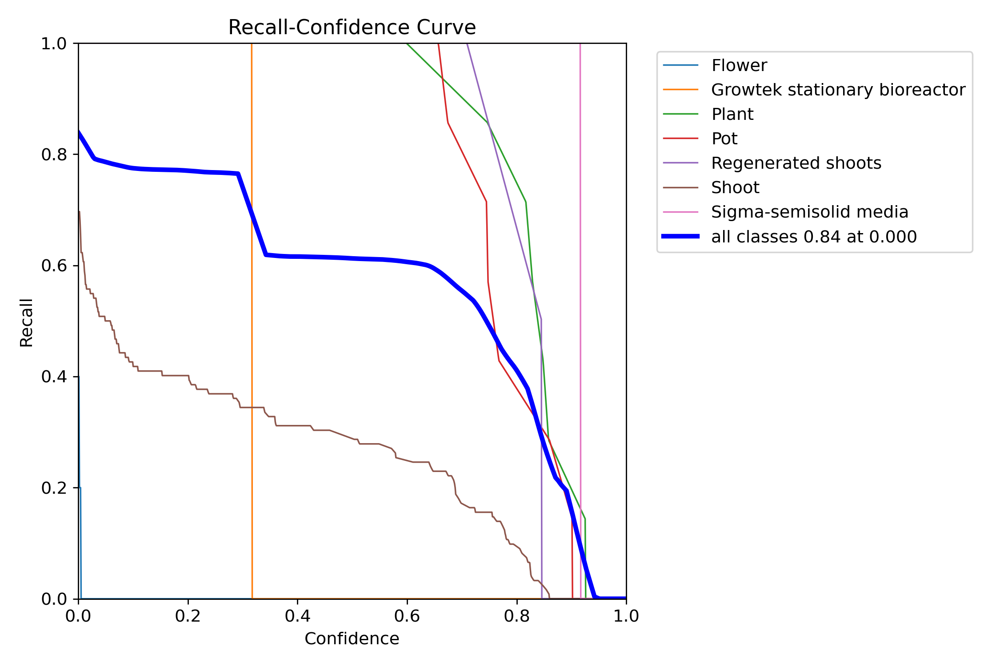

In [57]:
Image ("/content/runs/detect/val/R_curve.png", width= 600)

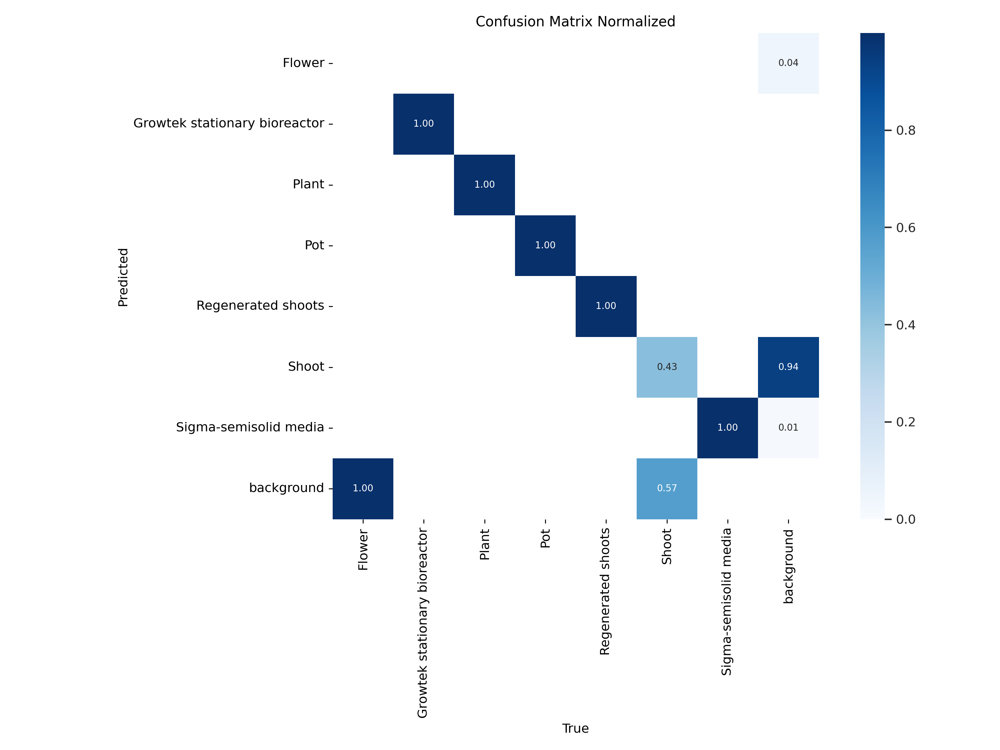

In [56]:
Image ("/content/runs/detect/val/confusion_matrix_normalized.png", width= 900)

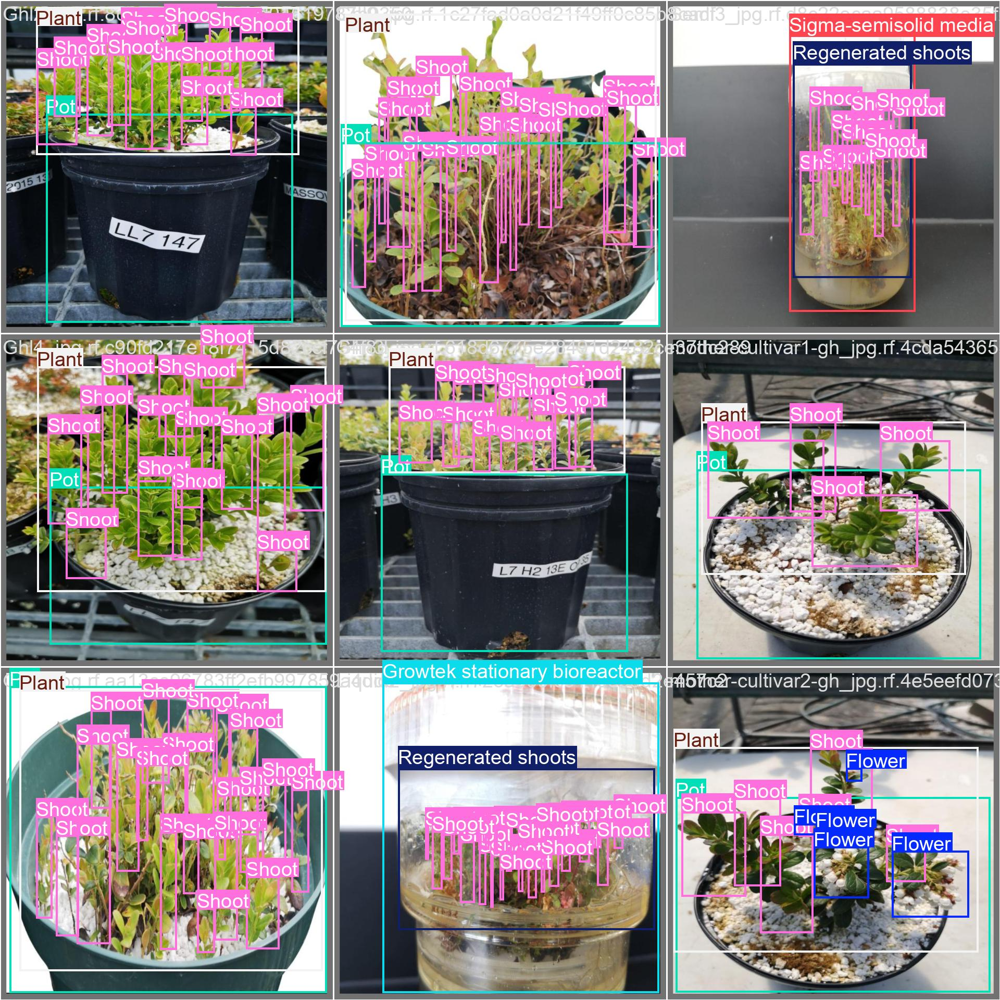

In [79]:
Image ("/content/runs/detect/val/val_batch0_labels.jpg", width= 900)

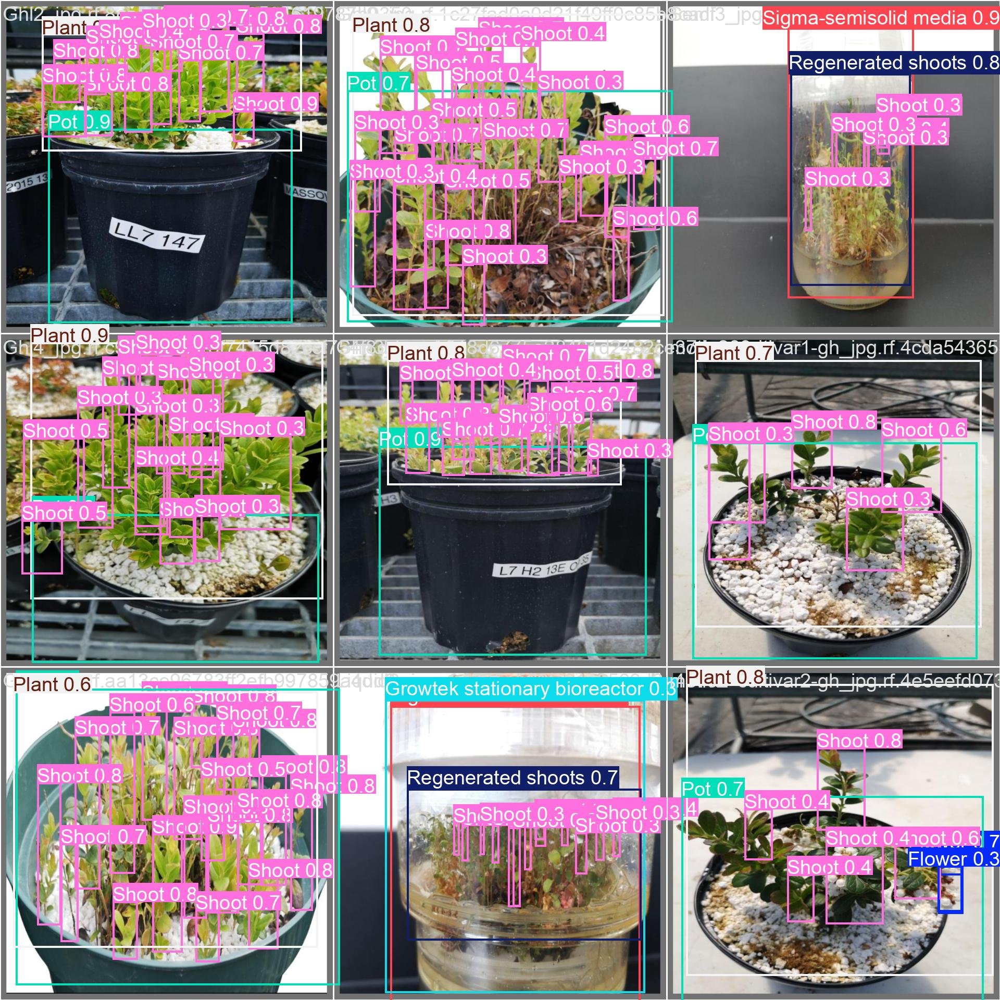

In [80]:
Image ("/content/runs/detect/val/val_batch0_pred.jpg", width= 900)

In [36]:
! yolo task=detect mode=predict model="/content/runs/detect/train/weights/best.pt" conf=0.25 source={dataset.location}/test/images save=True

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs

image 1/9 /content/Lingonberry-detection-6/test/images/Ghl10_jpg.rf.81f075790a280103a15dfe6f825ed8aa.jpg: 800x800 1 Plant, 1 Pot, 16 Shoots, 29.4ms
image 2/9 /content/Lingonberry-detection-6/test/images/Ghl1_jpg.rf.6a856fb8fd696ccd3bda5c356b1665a2.jpg: 800x800 1 Plant, 3 Pots, 20 Shoots, 29.5ms
image 3/9 /content/Lingonberry-detection-6/test/images/Ghn1_jpg.rf.49f4ff1cfce48e9cfd7de94d25f0a409.jpg: 800x800 1 Plant, 1 Pot, 19 Shoots, 29.4ms
image 4/9 /content/Lingonberry-detection-6/test/images/Ghn5_jpg.rf.671795f1bd41467799fb4606066d6549.jpg: 800x800 1 Plant, 1 Pot, 8 Shoots, 29.4ms
image 5/9 /content/Lingonberry-detection-6/test/images/Semi2_jpg.rf.866676595eb62f1d2a6b84d98df71566.jpg: 800x800 1 Regenerated shoots, 15 Shoots, 1 Sigma-semisolid media, 29.4ms
image 6/9 /content/Lingonberry-detection-6/test/images/Semi4_jpg

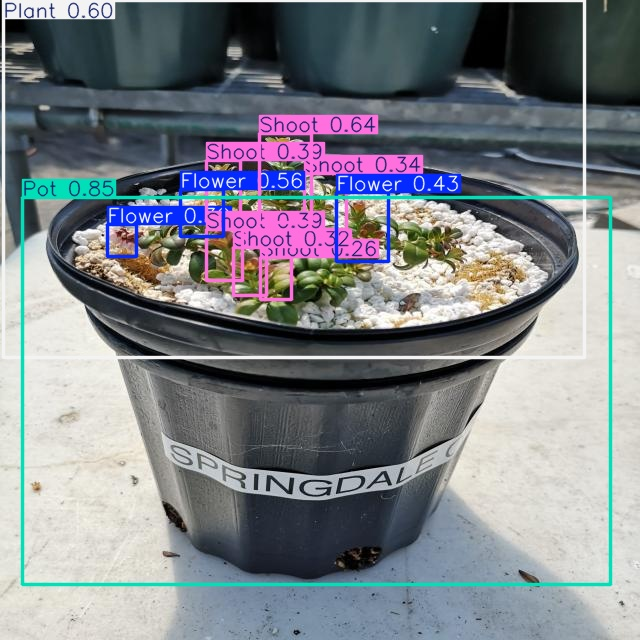

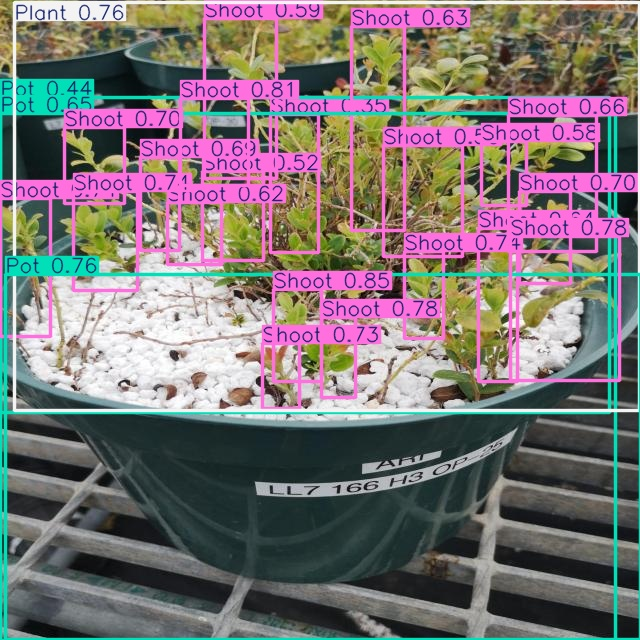

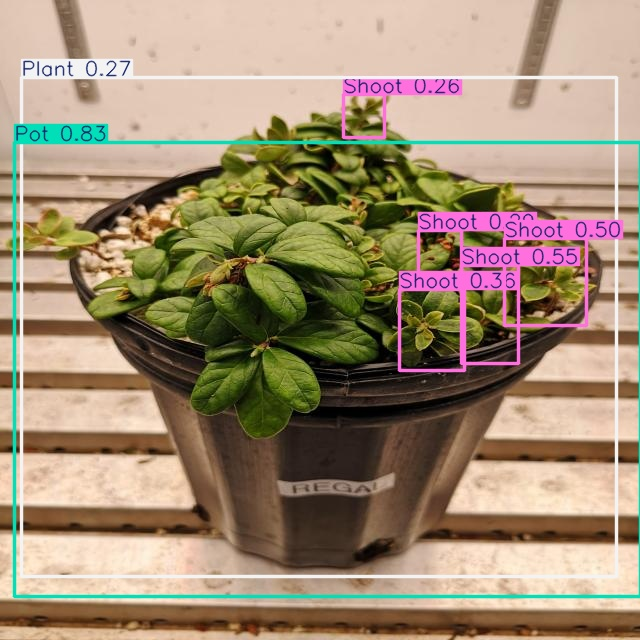

In [37]:
import glob
import os
from IPython.display import Image as IPyImage, display

latest_folder = max(glob.glob('/content/runs/detect/predict*/'), key=os.path.getmtime)
for img in glob.glob(f'{latest_folder}/*.jpg')[1:4]:
  display(IPyImage(filename=img, width=600))
  print("\n")

In [38]:
! yolo task=detect mode=predict model="/content/runs/detect/train/weights/best.pt" conf=0.25 source=/content/drive/MyDrive/cutting-cultivar03-gh.jpg save=True

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs

image 1/1 /content/drive/MyDrive/cutting-cultivar03-gh.jpg: 800x608 10 Flowers, 1 Plant, 1 Pot, 9 Shoots, 85.6ms
Speed: 7.7ms preprocess, 85.6ms inference, 193.6ms postprocess per image at shape (1, 3, 800, 608)
Results saved to runs/detect/predict2
💡 Learn more at https://docs.ultralytics.com/modes/predict


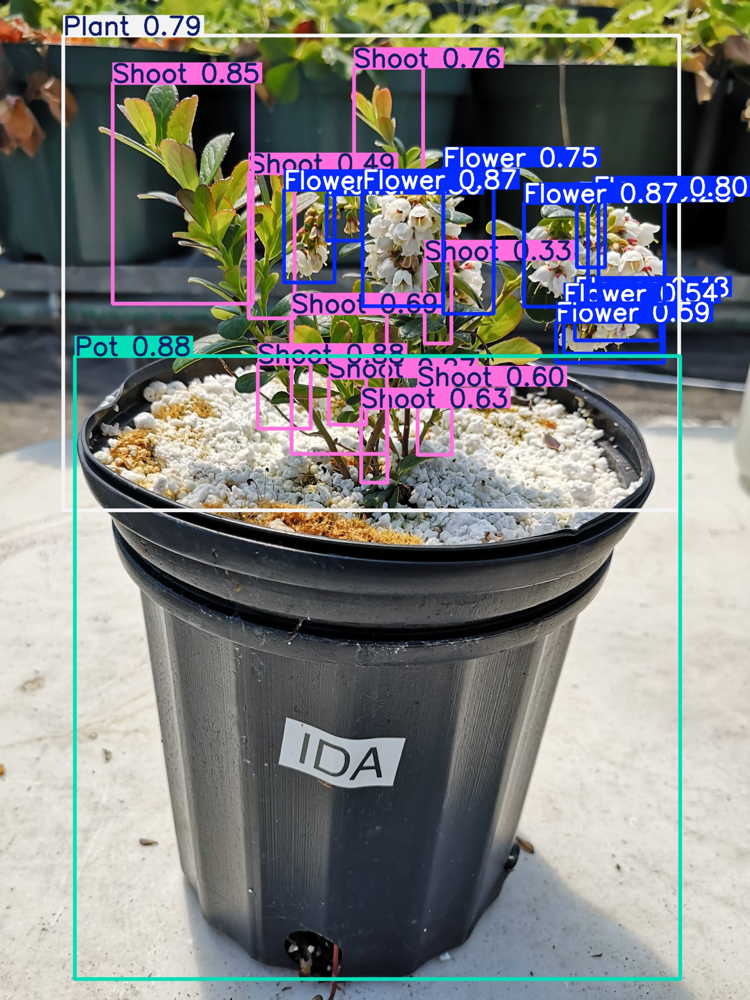

In [39]:
Image ("/content/runs/detect/predict2/cutting-cultivar03-gh.jpg", width= 1200)

In [41]:
!yolo task=detect mode=predict model="/content/runs/detect/train/weights/best.pt" conf=0.25 source=/content/drive/MyDrive/Semi3.jpg save=True

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs

image 1/1 /content/drive/MyDrive/Semi3.jpg: 608x800 1 Regenerated shoots, 6 Shoots, 1 Sigma-semisolid media, 55.3ms
Speed: 6.0ms preprocess, 55.3ms inference, 169.7ms postprocess per image at shape (1, 3, 608, 800)
Results saved to runs/detect/predict3
💡 Learn more at https://docs.ultralytics.com/modes/predict


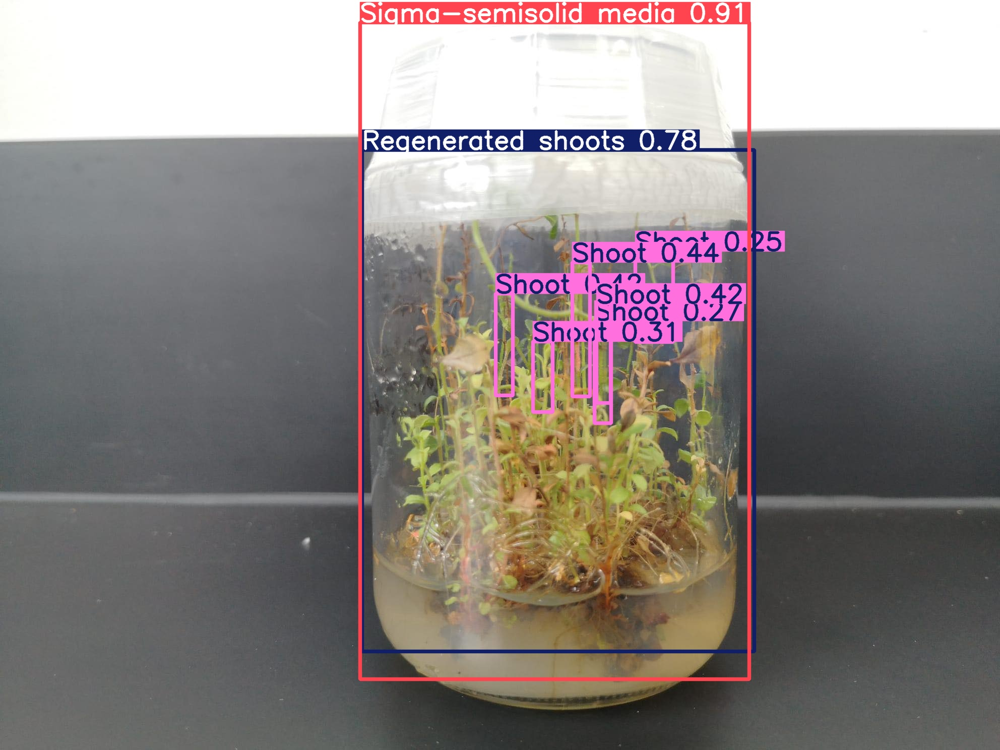

In [42]:
Image ("/content/runs/detect/predict3/Semi3.jpg", width= 1200)

In [43]:
!yolo task=detect mode=predict model="/content/runs/detect/train/weights/best.pt" conf=0.25 source=/content/drive/MyDrive/Liquid3.jpg save=True

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs

image 1/1 /content/drive/MyDrive/Liquid3.jpg: 800x608 2 Growtek stationary bioreactors, 1 Regenerated shoots, 3 Shoots, 91.1ms
Speed: 11.3ms preprocess, 91.1ms inference, 200.3ms postprocess per image at shape (1, 3, 800, 608)
Results saved to runs/detect/predict4
💡 Learn more at https://docs.ultralytics.com/modes/predict


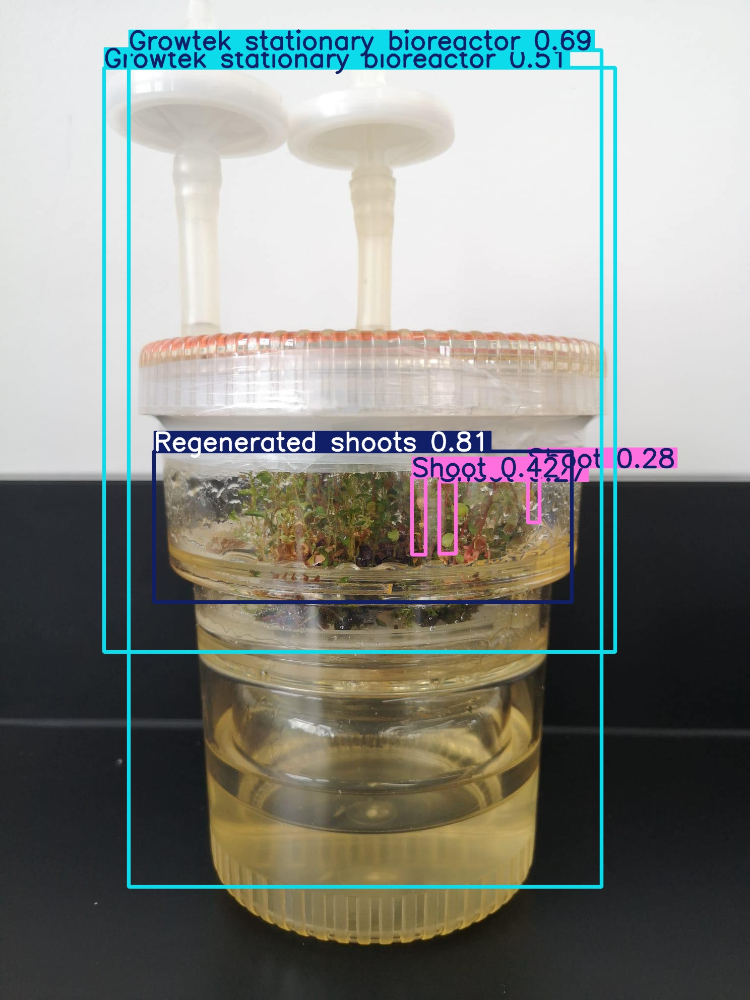

In [44]:
Image ("/content/runs/detect/predict4/Liquid3.jpg", width= 1200)

In [45]:
!yolo task=detect mode=predict model="/content/runs/detect/train/weights/best.pt" conf=0.25 source=/content/drive/MyDrive/Liquid2.jpg save=True

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs

image 1/1 /content/drive/MyDrive/Liquid2.jpg: 608x800 1 Growtek stationary bioreactor, 12 Shoots, 56.3ms
Speed: 6.1ms preprocess, 56.3ms inference, 141.1ms postprocess per image at shape (1, 3, 608, 800)
Results saved to runs/detect/predict5
💡 Learn more at https://docs.ultralytics.com/modes/predict


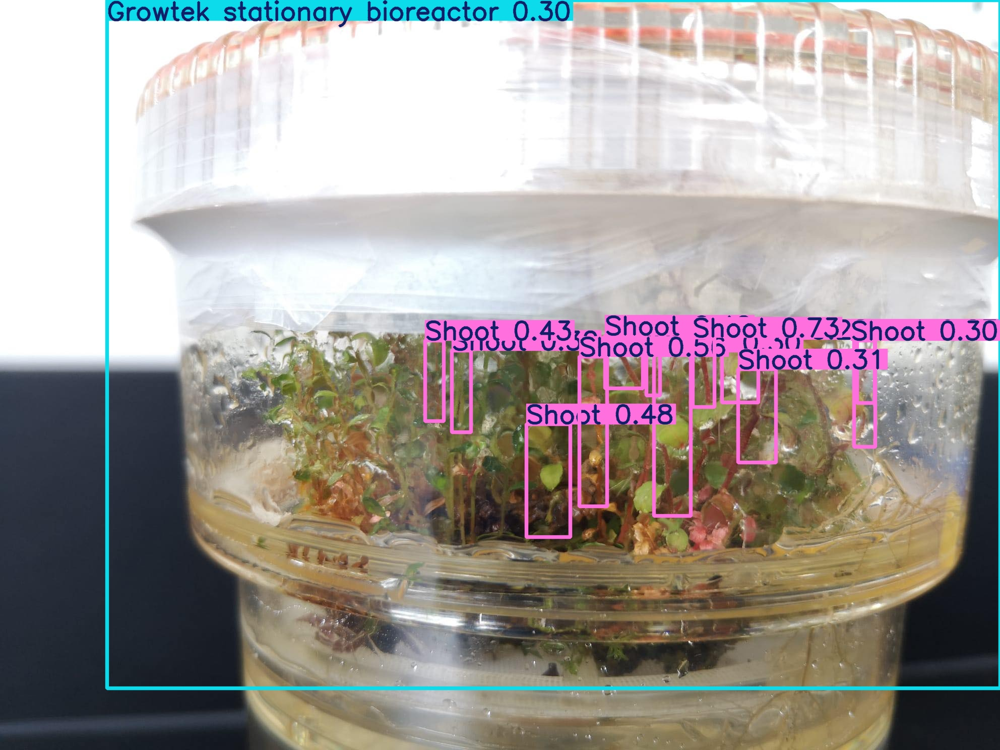

In [46]:
Image ("/content/runs/detect/predict5/Liquid2.jpg", width= 1200)

In [47]:
!yolo task=detect mode=predict model="/content/runs/detect/train/weights/best.pt" conf=0.25 source=/content/drive/MyDrive/Ghn4-gr.jpg save=True

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs

image 1/1 /content/drive/MyDrive/Ghn4-gr.jpg: 800x608 1 Pot, 11 Shoots, 63.9ms
Speed: 10.3ms preprocess, 63.9ms inference, 164.2ms postprocess per image at shape (1, 3, 800, 608)
Results saved to runs/detect/predict6
💡 Learn more at https://docs.ultralytics.com/modes/predict


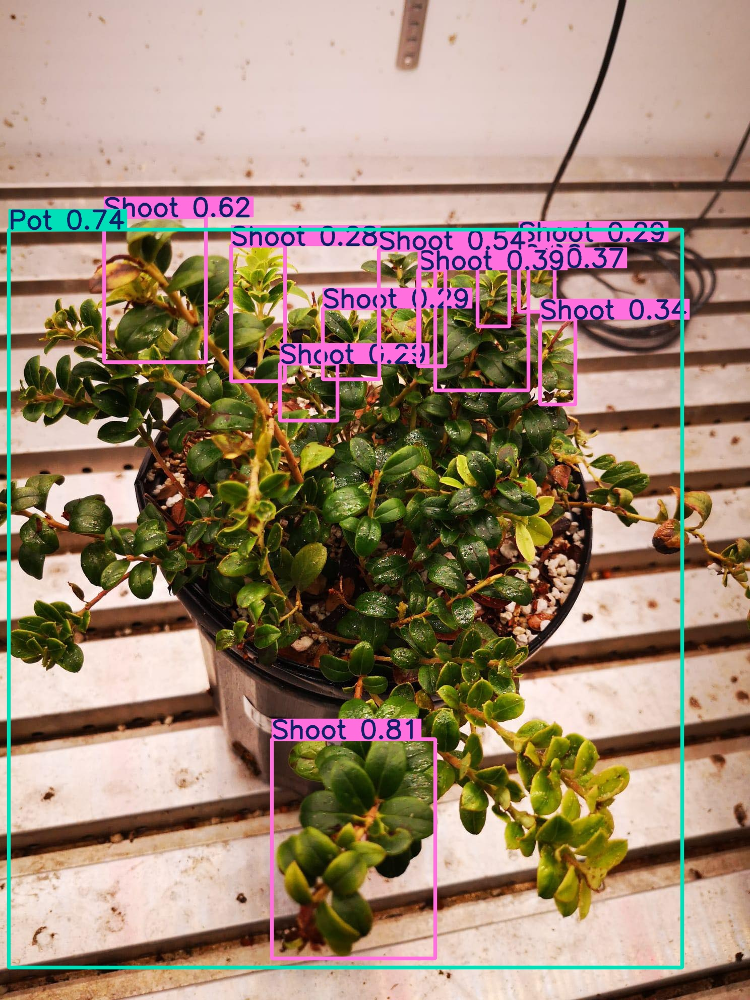

In [48]:
Image ("/content/runs/detect/predict6/Ghn4-gr.jpg", width= 1200)

In [49]:
!yolo task=detect mode=predict model="/content/runs/detect/train/weights/best.pt" conf=0.25 source=/content/drive/MyDrive/Ghn3.jpg save=True

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs

image 1/1 /content/drive/MyDrive/Ghn3.jpg: 800x608 1 Plant, 2 Pots, 15 Shoots, 90.2ms
Speed: 9.6ms preprocess, 90.2ms inference, 224.2ms postprocess per image at shape (1, 3, 800, 608)
Results saved to runs/detect/predict7
💡 Learn more at https://docs.ultralytics.com/modes/predict


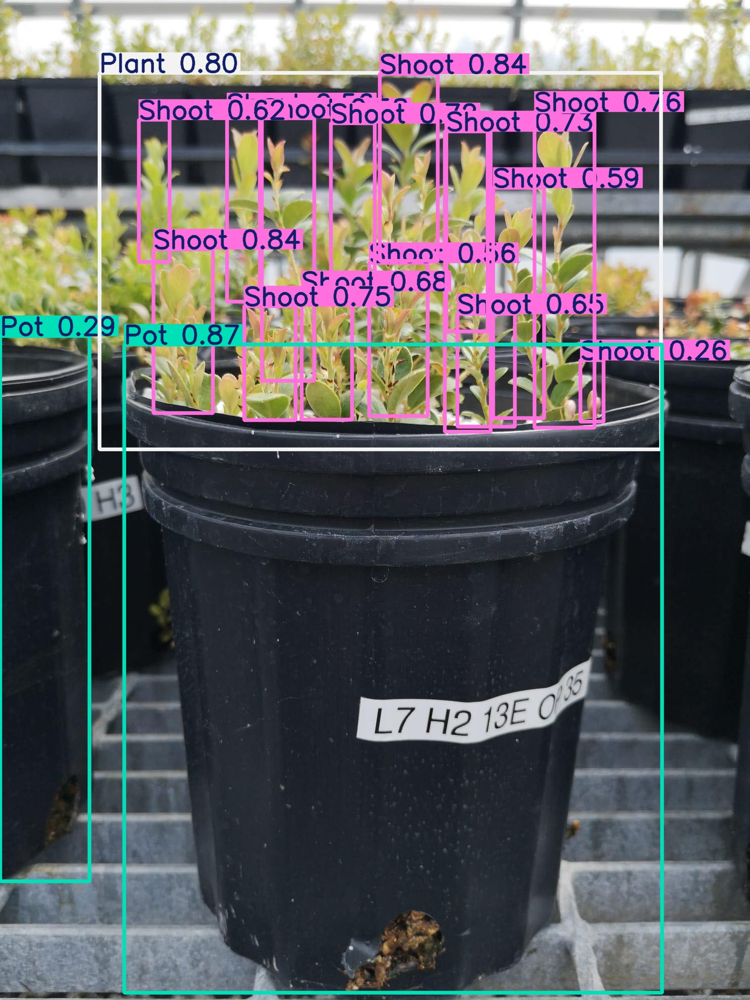

In [50]:
Image ("/content/runs/detect/predict7/Ghn3.jpg", width= 1200)

In [51]:
!yolo task=detect mode=predict model="/content/runs/detect/train/weights/best.pt" conf=0.25 source=/content/drive/MyDrive/Ghn3-gr.jpg save=True

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs

image 1/1 /content/drive/MyDrive/Ghn3-gr.jpg: 800x608 1 Flower, 1 Plant, 1 Pot, 13 Shoots, 54.8ms
Speed: 6.0ms preprocess, 54.8ms inference, 145.1ms postprocess per image at shape (1, 3, 800, 608)
Results saved to runs/detect/predict8
💡 Learn more at https://docs.ultralytics.com/modes/predict


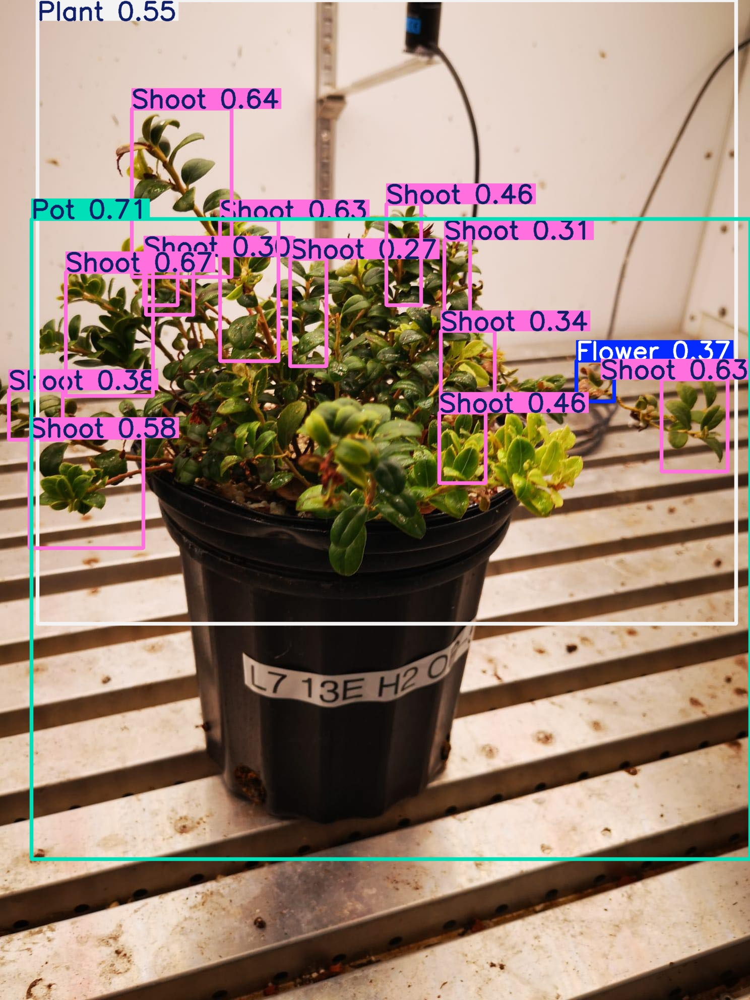

In [52]:
Image ("/content/runs/detect/predict8/Ghn3-gr.jpg", width= 1200)

In [53]:
!yolo task=detect mode=predict model="/content/runs/detect/train/weights/best.pt" conf=0.25 source=/content/drive/MyDrive/Ghl3.jpg save=True

Ultralytics 8.3.78 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs

image 1/1 /content/drive/MyDrive/Ghl3.jpg: 800x608 1 Plant, 1 Pot, 16 Shoots, 94.1ms
Speed: 9.4ms preprocess, 94.1ms inference, 222.8ms postprocess per image at shape (1, 3, 800, 608)
Results saved to runs/detect/predict9
💡 Learn more at https://docs.ultralytics.com/modes/predict


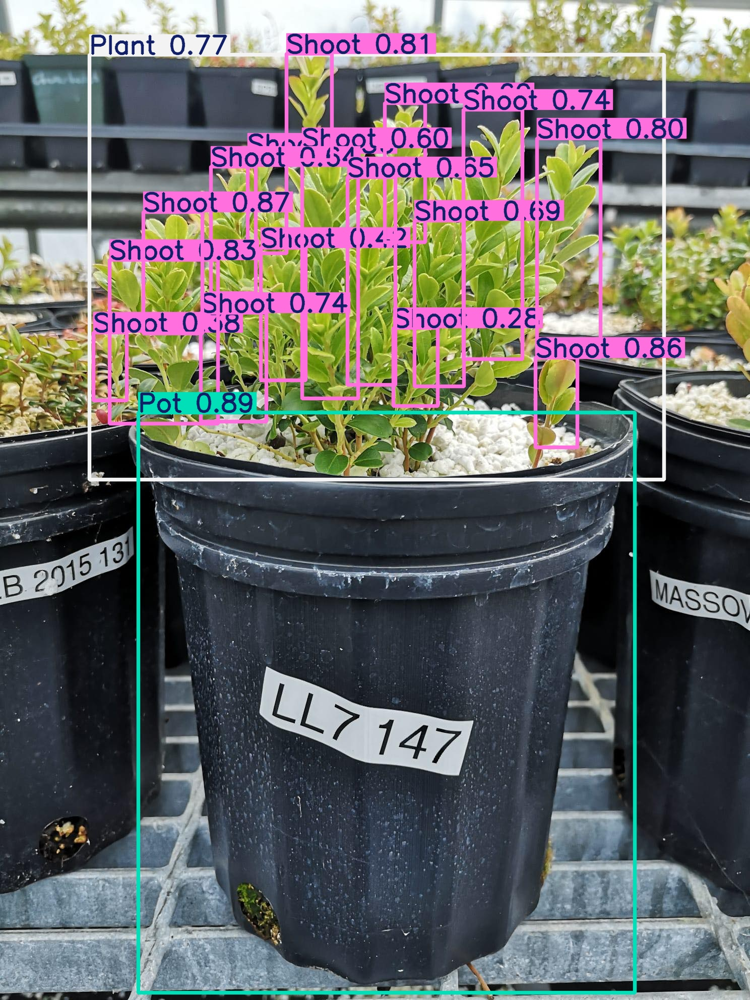

In [54]:
Image ("/content/runs/detect/predict9/Ghl3.jpg", width= 1200)

In [ ]:
# Thank you